let's try loading in our data.

In [1]:
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt
import ast
import numpy as np
from sklearn.feature_selection import VarianceThreshold

# Show all columns (adjust to 1000 or higher if needed)
#pd.set_option('display.max_columns', None)     # Show all columns
pd.set_option('display.expand_frame_repr', False)  # Don't wrap DataFrame across lines

now let's do breast cancer: "https://xenabrowser.net/datapages/?cohort=GDC%20TCGA%20Breast%20Cancer%20(BRCA)&removeHub=https%3A%2F%2Fxena.treehouse.gi.ucsc.edu%3A443"

In [ ]:
#breast_path = "/Users/tirdodbehbehani/Desktop/BSE/Term 3/Thesis/master_thesis_git/data/BREAST"
breast_path = "C:/Users/usuario/OneDrive/Desktop/Thesis/master_thesis/data/BREAST"
#breast_path="/Users/inigo/Downloads/DATA/BREAST"

In [58]:
# Adjust the filename if you're using FPKM-UQ
breast_gene_expression_path = os.path.join(breast_path, "TCGA-BRCA.star_tpm.tsv.gz")
breast_gene_expression = pd.read_csv(breast_gene_expression_path, sep='\t', index_col=0)

# Inspect the data
breast_gene_expression.head()

,TCGA-D8-A146-01A,TCGA-AQ-A0Y5-01A,TCGA-C8-A274-01A,TCGA-BH-A0BD-01A,TCGA-B6-A1KC-01B,TCGA-AC-A62V-01A,TCGA-AO-A0J5-01A,TCGA-BH-A0B1-01A,TCGA-A2-A0YM-01A,TCGA-AO-A03N-01B,...,TCGA-E2-A1IG-01A,TCGA-E9-A1NA-01A,TCGA-D8-A1JP-01A,TCGA-AR-A252-01A,TCGA-D8-A1XL-01A,TCGA-BH-A0EI-01A,TCGA-E2-A1IO-01A,TCGA-E2-A15R-01A,TCGA-B6-A0IP-01A,TCGA-A1-A0SN-01A
Ensembl_ID,,,,,,,,,,,,,,,,,,,,,
ENSG00000000003.15,5.662037,3.703721,6.514515,4.784917,4.251984,3.536849,4.645690,6.021755,6.260931,3.613025,...,4.825501,4.142806,4.960919,4.770121,5.276757,6.436490,6.184500,2.670931,6.834395,3.650719
ENSG00000000005.6,3.376096,0.463099,0.000000,2.328061,0.435415,0.736475,1.255622,0.392647,0.467593,0.000000,...,0.134747,0.159500,0.079566,3.312418,0.000000,0.383608,0.755144,0.479644,0.526069,0.059909
ENSG00000000419.13,6.860140,7.086452,6.805072,6.443071,6.178436,6.823355,5.749910,6.977449,6.819887,6.079559,...,6.382933,6.436308,6.994589,6.005000,7.382161,7.220846,6.868277,7.033110,6.384368,8.153019
ENSG00000000457.14,4.400552,4.051007,5.037264,4.374970,3.558464,2.108324,4.487107,4.021000,3.319560,2.287502,...,3.891448,3.765057,4.946796,3.648707,3.664915,3.752192,4.093078,4.831796,4.368028,4.172247
ENSG00000000460.17,2.845169,2.426989,4.043248,4.162790,2.589548,2.277777,2.545178,3.372492,4.023974,1.753177,...,2.557655,2.566596,3.746915,2.494160,3.104957,3.111549,2.538538,3.730901,3.311721,3.301075


In [59]:
breast_survival_path = os.path.join(breast_path, "TCGA-BRCA.survival.tsv.gz")
breast_survival = pd.read_csv(breast_survival_path, sep='\t')

# Inspect
breast_survival.head()

,sample,OS.time,OS,_PATIENT
0,TCGA-C8-A275-01A,1.0,0,TCGA-C8-A275
1,TCGA-AC-A7VC-01A,1.0,0,TCGA-AC-A7VC
2,TCGA-BH-A1F8-01A,1.0,1,TCGA-BH-A1F8
3,TCGA-BH-A1F8-11B,1.0,1,TCGA-BH-A1F8
4,TCGA-PL-A8LX-01A,5.0,0,TCGA-PL-A8LX


In [60]:
breast_pheno_path = os.path.join(breast_path, "TCGA-BRCA.clinical.tsv.gz")
breast_phenotype = pd.read_csv(breast_pheno_path, sep='\t')

# Inspect
breast_phenotype.head()

,sample,id,disease_type,case_id,submitter_id,primary_site,alcohol_history.exposures,race.demographic,gender.demographic,ethnicity.demographic,...,days_to_collection.samples,initial_weight.samples,preservation_method.samples,pathology_report_uuid.samples,oct_embedded.samples,specimen_type.samples,days_to_sample_procurement.samples,is_ffpe.samples,tissue_type.samples,annotations.samples
0,TCGA-BH-A0W3-01A,3c612e12-6de8-44fa-a095-805c45474821,Ductal and Lobular Neoplasms,3c612e12-6de8-44fa-a095-805c45474821,TCGA-BH-A0W3,Breast,Not Reported,white,female,not hispanic or latino,...,85.0,120.0,OCT,801A4E2F-E26E-424F-BF42-CD0D9CD62BCE,True,Solid Tissue,NaN,False,Tumor,NaN
1,TCGA-AR-A24V-01A,3cb06c7a-f2a8-448b-91a8-dd201bbf2ddd,Ductal and Lobular Neoplasms,3cb06c7a-f2a8-448b-91a8-dd201bbf2ddd,TCGA-AR-A24V,Breast,Not Reported,white,female,not hispanic or latino,...,1720.0,400.0,OCT,468CD293-C9F7-43C6-A40A-18FCDD22F6AA,True,Solid Tissue,NaN,False,Tumor,NaN
2,TCGA-E9-A1NE-01A,3d676bba-154b-4d22-ab59-d4d4da051b94,Ductal and Lobular Neoplasms,3d676bba-154b-4d22-ab59-d4d4da051b94,TCGA-E9-A1NE,Breast,Not Reported,white,female,not hispanic or latino,...,31.0,280.0,OCT,CF6E29A2-FAE6-45BB-B625-33877887A89E,True,Solid Tissue,NaN,False,Tumor,NaN
3,TCGA-E9-A1NE-11A,3d676bba-154b-4d22-ab59-d4d4da051b94,Ductal and Lobular Neoplasms,3d676bba-154b-4d22-ab59-d4d4da051b94,TCGA-E9-A1NE,Breast,Not Reported,white,female,not hispanic or latino,...,31.0,830.0,OCT,NaN,True,Solid Tissue,NaN,False,Normal,NaN
4,TCGA-AC-A8OQ-01A,dfaabd03-2d40-4422-b210-caf112ff4229,Ductal and Lobular Neoplasms,dfaabd03-2d40-4422-b210-caf112ff4229,TCGA-AC-A8OQ,Breast,Not Reported,black or african american,female,not hispanic or latino,...,742.0,100.0,Unknown,FFA6F9F3-71C1-4AF9-B9F7-0466550EBC90,False,Solid Tissue,NaN,False,Tumor,NaN


In [61]:
# Transpose the liver_gene_expression matrix so that sample IDs are columns
breast_gene_expression_transposed = breast_gene_expression.T  # Sample IDs become columns

# Now, rename the index to 'sample_id' (assuming the index is the sample_id after transposition)
breast_gene_expression_transposed.reset_index(inplace=True)
breast_gene_expression_transposed.rename(columns={'index': 'sample'}, inplace=True)

# Merge the transposed gene expression dataframe with the liver_survival and liver_phenotype dataframes
breast_combined_df = breast_gene_expression_transposed.merge(breast_survival, on='sample', how='inner') \
                                                   .merge(breast_phenotype, on='sample', how='inner')

# Display the shape of the combined dataframe
print(f"Combined breast dataframe shape: {breast_combined_df.shape}")

Combined breast dataframe shape: (1203, 60748)


In [62]:
breast_combined_df.head()

,sample,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,...,days_to_collection.samples,initial_weight.samples,preservation_method.samples,pathology_report_uuid.samples,oct_embedded.samples,specimen_type.samples,days_to_sample_procurement.samples,is_ffpe.samples,tissue_type.samples,annotations.samples
0,TCGA-D8-A146-01A,5.662037,3.376096,6.860140,4.400552,2.845169,3.579965,4.996181,5.614683,4.385652,...,221.0,230.0,Unknown,79749F5D-329A-400D-8511-C4CF479C1FCC,False,Solid Tissue,NaN,False,Tumor,NaN
1,TCGA-AQ-A0Y5-01A,3.703721,0.463099,7.086452,4.051007,2.426989,2.322361,4.943860,6.539078,4.046404,...,212.0,160.0,Unknown,5BC01981-366E-44EC-A986-087DB7904E5C,False,Solid Tissue,NaN,False,Tumor,NaN
2,TCGA-C8-A274-01A,6.514515,0.000000,6.805072,5.037264,4.043248,2.124130,2.993348,5.119912,3.409907,...,163.0,470.0,OCT,A7FAA4F2-1846-48CF-9FB5-15E98430F6CE,True,Solid Tissue,NaN,False,Tumor,NaN
3,TCGA-BH-A0BD-01A,4.784917,2.328061,6.443071,4.374970,4.162790,3.122375,4.754674,5.608738,3.625691,...,364.0,90.0,OCT,CE70DD1E-BCA4-4F89-AA5B-D90FE18A36FF,True,Solid Tissue,NaN,False,Tumor,NaN
4,TCGA-B6-A1KC-01B,4.251984,0.435415,6.178436,3.558464,2.589548,1.508581,3.722149,5.224044,3.242221,...,2781.0,50.0,OCT,E1FDF8EB-9D75-4629-9C78-6019DAF8190E,True,Solid Tissue,NaN,False,Tumor,NaN


In [63]:
print("\nBreast Cancer DataFrames:")
print("Gene Expression Shape:", breast_gene_expression.shape)
print("Survival Shape:", breast_survival.shape)
print("Phenotype Shape:", breast_phenotype.shape)


Breast Cancer DataFrames:
Gene Expression Shape: (60660, 1226)
Survival Shape: (1232, 4)
Phenotype Shape: (1255, 85)


----------------------------

BREAST CANCER

In [64]:
# Print the list of columns in the breast_combined_df DataFrame
print(breast_combined_df.columns.to_list())

# Select only the columns that start with 'ENSG' (gene identifiers)
genes_only = breast_combined_df.loc[:, breast_combined_df.columns.str.startswith('ENSG')]

# Create a gene summary DataFrame with descriptive statistics for each gene
gene_summary = pd.DataFrame({
    'mean': genes_only.mean(),
    'median': genes_only.median(),
    'std': genes_only.std(),
    'min': genes_only.min(),
    'max': genes_only.max(),
    'non_zero_count': (genes_only > 0).sum(),
    'zero_frac': (genes_only == 0).sum() / genes_only.shape[0],
    'missing_frac': genes_only.isna().mean()
})

# Print the first few rows of the gene summary and the shape of the genes_only DataFrame
print(gene_summary.head())
print(genes_only.shape)


['sample', 'ENSG00000000003.15', 'ENSG00000000005.6', 'ENSG00000000419.13', 'ENSG00000000457.14', 'ENSG00000000460.17', 'ENSG00000000938.13', 'ENSG00000000971.16', 'ENSG00000001036.14', 'ENSG00000001084.13', 'ENSG00000001167.14', 'ENSG00000001460.18', 'ENSG00000001461.17', 'ENSG00000001497.18', 'ENSG00000001561.7', 'ENSG00000001617.12', 'ENSG00000001626.16', 'ENSG00000001629.10', 'ENSG00000001630.17', 'ENSG00000001631.16', 'ENSG00000002016.18', 'ENSG00000002079.14', 'ENSG00000002330.14', 'ENSG00000002549.12', 'ENSG00000002586.20', 'ENSG00000002586.20_PAR_Y', 'ENSG00000002587.10', 'ENSG00000002726.21', 'ENSG00000002745.13', 'ENSG00000002746.15', 'ENSG00000002822.15', 'ENSG00000002834.18', 'ENSG00000002919.15', 'ENSG00000002933.9', 'ENSG00000003056.8', 'ENSG00000003096.14', 'ENSG00000003137.8', 'ENSG00000003147.19', 'ENSG00000003249.15', 'ENSG00000003393.15', 'ENSG00000003400.15', 'ENSG00000003402.20', 'ENSG00000003436.16', 'ENSG00000003509.16', 'ENSG00000003756.17', 'ENSG00000003987.14'

In [65]:
# Identify the columns that are gene IDs (those starting with "ENSG")
gene_columns = breast_combined_df.columns[breast_combined_df.columns.str.startswith('ENSG')]

# Update the column names by removing the version number after the gene ID
breast_combined_df.rename(columns={col: col.split('.')[0] for col in gene_columns}, inplace=True)

#(Different datasets may use different versions of gene annotations. Removing .15 makes it easier to merge or compare across datasets.)
breast_combined_df.head()

,sample,ENSG00000000003,ENSG00000000005,ENSG00000000419,ENSG00000000457,ENSG00000000460,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,...,days_to_collection.samples,initial_weight.samples,preservation_method.samples,pathology_report_uuid.samples,oct_embedded.samples,specimen_type.samples,days_to_sample_procurement.samples,is_ffpe.samples,tissue_type.samples,annotations.samples
0,TCGA-D8-A146-01A,5.662037,3.376096,6.860140,4.400552,2.845169,3.579965,4.996181,5.614683,4.385652,...,221.0,230.0,Unknown,79749F5D-329A-400D-8511-C4CF479C1FCC,False,Solid Tissue,NaN,False,Tumor,NaN
1,TCGA-AQ-A0Y5-01A,3.703721,0.463099,7.086452,4.051007,2.426989,2.322361,4.943860,6.539078,4.046404,...,212.0,160.0,Unknown,5BC01981-366E-44EC-A986-087DB7904E5C,False,Solid Tissue,NaN,False,Tumor,NaN
2,TCGA-C8-A274-01A,6.514515,0.000000,6.805072,5.037264,4.043248,2.124130,2.993348,5.119912,3.409907,...,163.0,470.0,OCT,A7FAA4F2-1846-48CF-9FB5-15E98430F6CE,True,Solid Tissue,NaN,False,Tumor,NaN
3,TCGA-BH-A0BD-01A,4.784917,2.328061,6.443071,4.374970,4.162790,3.122375,4.754674,5.608738,3.625691,...,364.0,90.0,OCT,CE70DD1E-BCA4-4F89-AA5B-D90FE18A36FF,True,Solid Tissue,NaN,False,Tumor,NaN
4,TCGA-B6-A1KC-01B,4.251984,0.435415,6.178436,3.558464,2.589548,1.508581,3.722149,5.224044,3.242221,...,2781.0,50.0,OCT,E1FDF8EB-9D75-4629-9C78-6019DAF8190E,True,Solid Tissue,NaN,False,Tumor,NaN


In [66]:
# Create a sample summary DataFrame using the breast_combined_df DataFrame
sample_summary = pd.DataFrame({
    'sample': breast_combined_df['sample'],
    'sum_expr': genes_only.sum(axis=1),
    'mean_expr': genes_only.mean(axis=1),
    'median_expr': genes_only.median(axis=1),
    'non_zero_genes': (genes_only > 0).sum(axis=1),
    'missing_frac': genes_only.isna().mean(axis=1)
})

# Display the first few rows of the sample summary
print(sample_summary.head())


             sample      sum_expr  mean_expr  median_expr  non_zero_genes  missing_frac
0  TCGA-D8-A146-01A  78210.101483   1.289319     0.129745           34318           0.0
1  TCGA-AQ-A0Y5-01A  70795.021063   1.167079     0.068602           32629           0.0
2  TCGA-C8-A274-01A  69208.084410   1.140918     0.065986           33349           0.0
3  TCGA-BH-A0BD-01A  73473.931447   1.211242     0.096802           33807           0.0
4  TCGA-B6-A1KC-01B  64654.793628   1.065855     0.056792           33268           0.0


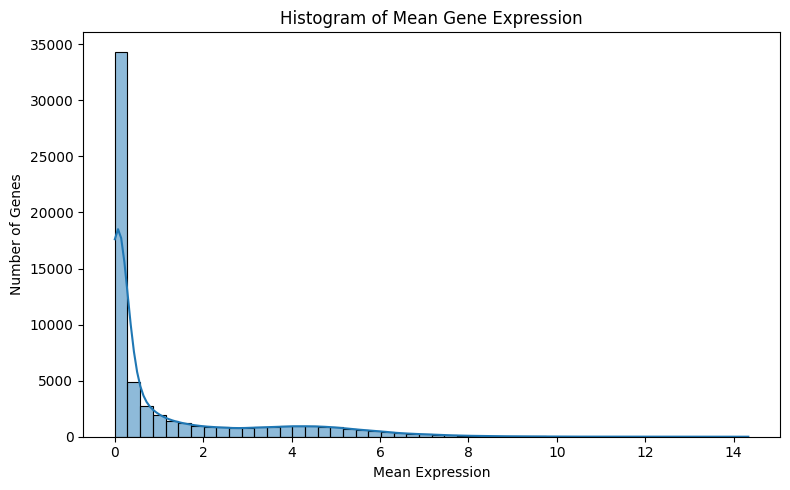

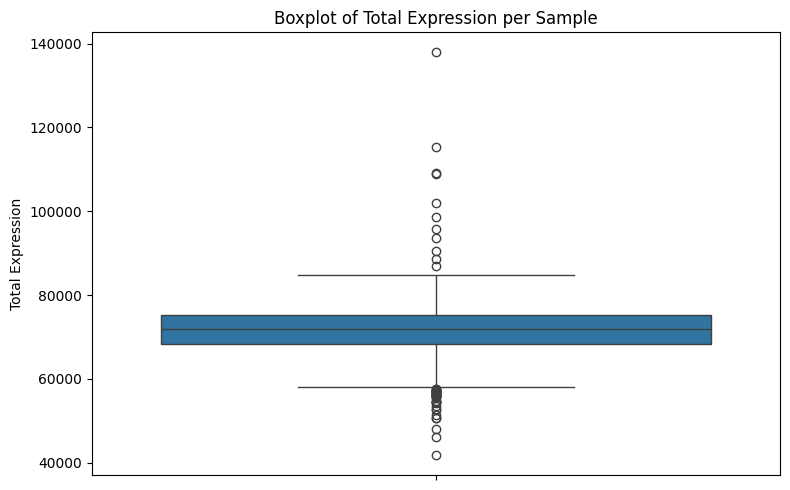

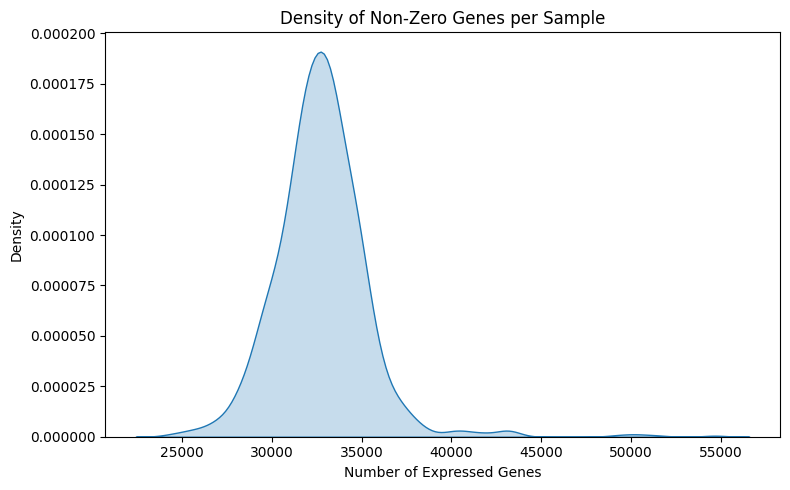

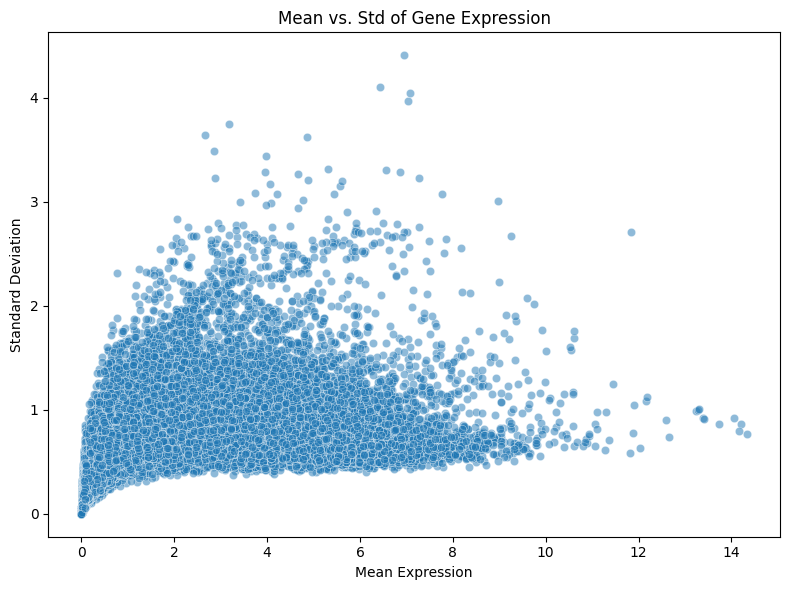

In [67]:
# Summary for genes
gene_summary = pd.DataFrame({
    'mean': genes_only.mean(),
    'std': genes_only.std()
})

# Summary for samples
sample_summary = pd.DataFrame({
    'sum_expr': genes_only.sum(axis=1),
    'mean_expr': genes_only.mean(axis=1),
    'non_zero_genes': (genes_only > 0).sum(axis=1)
})

# Histogram of Mean Gene Expression
plt.figure(figsize=(8, 5))
sns.histplot(gene_summary['mean'], bins=50, kde=True)
plt.title('Histogram of Mean Gene Expression')
plt.xlabel('Mean Expression')
plt.ylabel('Number of Genes')
plt.tight_layout()
plt.show()

# Boxplot of Total Expression per Sample
plt.figure(figsize=(8, 5))
sns.boxplot(y=sample_summary['sum_expr'])
plt.title('Boxplot of Total Expression per Sample')
plt.ylabel('Total Expression')
plt.tight_layout()
plt.show()

# Density Plot of Number of Non-Zero Genes per Sample
plt.figure(figsize=(8, 5))
sns.kdeplot(sample_summary['non_zero_genes'], fill=True)
plt.title('Density of Non-Zero Genes per Sample')
plt.xlabel('Number of Expressed Genes')
plt.ylabel('Density')
plt.tight_layout()
plt.show()

# Scatterplot of Mean vs. Standard Deviation for Genes
plt.figure(figsize=(8, 6))
sns.scatterplot(data=gene_summary, x='mean', y='std', alpha=0.5)
plt.title('Mean vs. Std of Gene Expression')
plt.xlabel('Mean Expression')
plt.ylabel('Standard Deviation')
plt.tight_layout()
plt.show()


In [68]:
# Get all gene columns
gene_columns = breast_combined_df.columns[breast_combined_df.columns.str.startswith('ENSG')]

# Subset just the gene columns
gene_data = breast_combined_df[gene_columns]

# Count how many columns have all zero
all_zero_cols = (gene_data == 0).all(axis=0)

# Count how many columns have more than 80% zeros
eighty_percent_zero_cols = (gene_data == 0).mean(axis=0) > 0.8

# Number of all-zero gene columns
num_all_zero = all_zero_cols.sum()

# Number of >80% zero gene columns (this includes all-zero ones too)
num_eighty_percent_zero = eighty_percent_zero_cols.sum()

print(f"Number of gene columns with all zeros: {num_all_zero}")
print(f"Number of gene columns with >80% zeros: {num_eighty_percent_zero}")


Number of gene columns with all zeros: 2660
Number of gene columns with >80% zeros: 21146


In [69]:
# Remove columns with >80% zeros
breast_combined_df = breast_combined_df.drop(columns=eighty_percent_zero_cols[eighty_percent_zero_cols].index)

print(f"Shape after removal: {breast_combined_df.shape}")


Shape after removal: (1203, 39624)


“asymmetrical genes” are often genes with low variance across samples, Genes expressed in less than X% of samples, Genes with non-normal or highly skewed expression distributions. we'll remove those. They might be unreliable or uninformative for models

In [70]:
# Only on gene columns
gene_data_filtered = breast_combined_df[breast_combined_df.columns[breast_combined_df.columns.str.startswith('ENSG')]]

# Remove genes with near-zero variance
selector = VarianceThreshold(threshold=0.05)
gene_data_high_var = selector.fit_transform(gene_data_filtered)

# Get the retained gene names
retained_genes = gene_data_filtered.columns[selector.get_support()]

# Create a new DataFrame with just the retained gene columns
# Update breast_combined_df in-place
breast_combined_df = breast_combined_df[retained_genes.union(breast_combined_df.columns.difference(gene_data_filtered.columns))]

print(f"Shape after removal: {breast_combined_df.shape}")


Shape after removal: (1203, 33092)


MISSING VALUES

annotations.samples                                          1203
days_to_sample_procurement.samples                           1200
classification.annotations                                   1172
notes.annotations                                            1172
entity_id.annotations                                        1172
state.annotations                                            1172
status.annotations                                           1172
submitter_id.annotations                                     1172
created_datetime.annotations                                 1172
category.annotations                                         1172
entity_type.annotations                                      1172
case_submitter_id.annotations                                1172
case_id.annotations                                          1172
annotation_id.annotations                                    1172
updated_datetime.annotations                                 1172
entity_sub

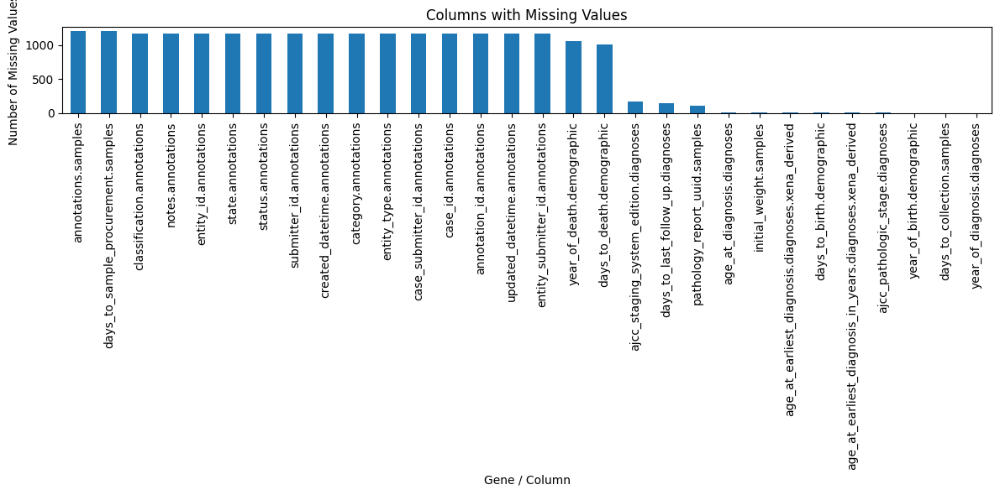

In [71]:
# Get missing value counts per column
missing_values = breast_combined_df.isna().sum()
missing_values = missing_values[missing_values > 0]

# Sort missing values in descending order (optional)
missing_values = missing_values.sort_values(ascending=False)
print(missing_values)

# Plot the missing values counts per column
plt.figure(figsize=(12, 6))
missing_values.plot(kind='bar')
plt.title("Columns with Missing Values")
plt.ylabel("Number of Missing Values")
plt.xlabel("Gene / Column")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [72]:
# ---------------------------
# 2. Drop Unnecessary Columns
# ---------------------------

# Drop all columns that end with '.annotations'
breast_combined_df = breast_combined_df.drop(
    columns=[col for col in breast_combined_df.columns if col.endswith('.annotations')]
)

# Drop ID-like columns (those containing 'uuid', 'submitter_id', 'entity_', or 'case_id')
id_like_cols = [
    col for col in breast_combined_df.columns 
    if 'uuid' in col or 'submitter_id' in col or 'entity_' in col or 'case_id' in col
]
breast_combined_df = breast_combined_df.drop(columns=id_like_cols)



In [73]:
breast_combined_df = breast_combined_df.drop(columns=['days_to_death.demographic'])



# 4. Missing Values 


In [74]:
# Get updated missing value counts per column after the fill
missing_values = breast_combined_df.isna().sum()
missing_values = missing_values[missing_values > 0]
missing_values = missing_values.sort_values(ascending=False)
print(missing_values)

annotations.samples                                          1203
days_to_sample_procurement.samples                           1200
year_of_death.demographic                                    1060
ajcc_staging_system_edition.diagnoses                         174
days_to_last_follow_up.diagnoses                              143
age_at_diagnosis.diagnoses                                     15
age_at_earliest_diagnosis.diagnoses.xena_derived               15
age_at_earliest_diagnosis_in_years.diagnoses.xena_derived      15
days_to_birth.demographic                                      15
initial_weight.samples                                         15
ajcc_pathologic_stage.diagnoses                                12
year_of_birth.demographic                                       3
days_to_collection.samples                                      2
year_of_diagnosis.diagnoses                                     2
dtype: int64


In [75]:
cols_to_drop = ['year_of_death.demographic', 'annotations.samples' ,'days_to_sample_procurement.samples']
breast_combined_df = breast_combined_df.drop(columns=cols_to_drop)
# Check for missing values again        
missing_values = breast_combined_df.isna().sum()
missing_values = missing_values[missing_values > 0]
missing_values = missing_values.sort_values(ascending=False)
print(missing_values)

ajcc_staging_system_edition.diagnoses                        174
days_to_last_follow_up.diagnoses                             143
age_at_diagnosis.diagnoses                                    15
age_at_earliest_diagnosis.diagnoses.xena_derived              15
age_at_earliest_diagnosis_in_years.diagnoses.xena_derived     15
days_to_birth.demographic                                     15
initial_weight.samples                                        15
ajcc_pathologic_stage.diagnoses                               12
year_of_birth.demographic                                      3
days_to_collection.samples                                     2
year_of_diagnosis.diagnoses                                    2
dtype: int64


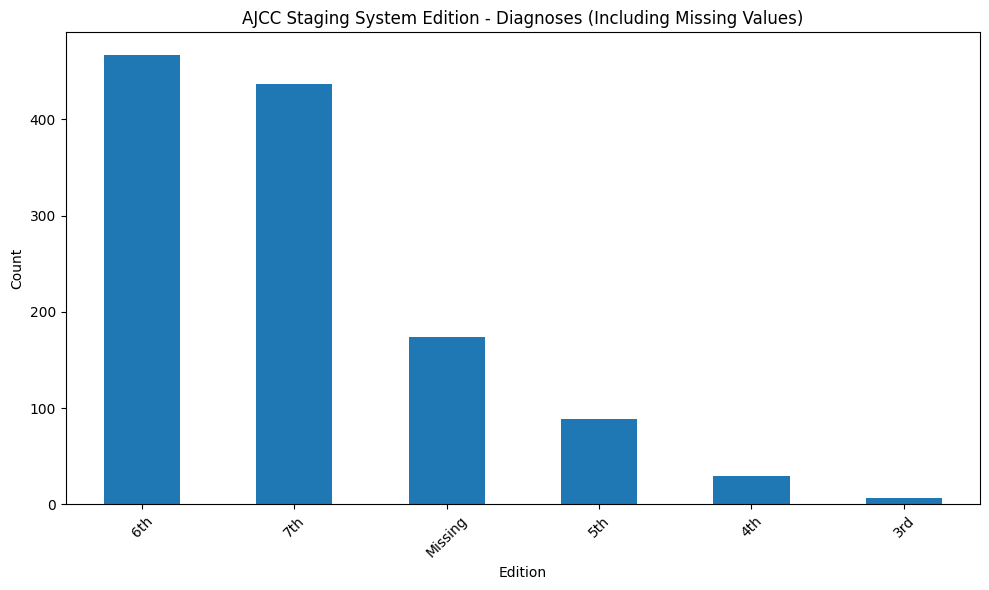

In [76]:
# Include NaNs in the value counts
value_counts = breast_combined_df['ajcc_staging_system_edition.diagnoses'].value_counts(dropna=False)

# Replace NaN with a label for plotting
value_counts.index = value_counts.index.fillna('Missing')

# Plot
plt.figure(figsize=(10, 6))
value_counts.plot(kind='bar')
plt.title('AJCC Staging System Edition - Diagnoses (Including Missing Values)')
plt.xlabel('Edition')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [77]:
# Add a New Category for "Missing"
breast_combined_df['ajcc_staging_system_edition.diagnoses'] = breast_combined_df['ajcc_staging_system_edition.diagnoses'].fillna('Missing')
# this is just the edition, we'll drop this 

In [78]:
breast_combined_df = breast_combined_df.drop(columns=[
    'days_to_last_follow_up.diagnoses',
    'days_to_birth.demographic',
    'ajcc_staging_system_edition.diagnoses'
])


In [79]:
# Create a DataFrame without columns that start with 'ENSG'
no_gene_breast_df = breast_combined_df.loc[:, ~breast_combined_df.columns.str.startswith('ENSG')]
no_gene_breast_df.head()

,OS,OS.time,_PATIENT,age_at_diagnosis.diagnoses,age_at_earliest_diagnosis.diagnoses.xena_derived,age_at_earliest_diagnosis_in_years.diagnoses.xena_derived,age_at_index.demographic,ajcc_pathologic_m.diagnoses,ajcc_pathologic_n.diagnoses,ajcc_pathologic_stage.diagnoses,...,tissue_type.samples,treatment_id.treatments.diagnoses,treatment_or_therapy.treatments.diagnoses,treatment_type.treatments.diagnoses,tumor_descriptor.samples,tumor_grade.diagnoses,updated_datetime.treatments.diagnoses,vital_status.demographic,year_of_birth.demographic,year_of_diagnosis.diagnoses
0,0,643.0,TCGA-D8-A146,20861.0,20861.0,57.153425,57.0,MX,N0,Stage IIA,...,Tumor,"['581bb6dd-a46b-55d3-ae18-669ce720ddc9', 'c4aa...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:30:12.724650-05:00', '2019-07-...",Alive,1953.0,2010.0
1,1,172.0,TCGA-AQ-A0Y5,25793.0,25793.0,70.665753,70.0,MX,N2a,Stage IIIA,...,Tumor,"['2fa57877-6c11-58a5-b59c-241ea22e978f', 'eef5...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:57:40.866216-05:00', '2019-07-...",Dead,1940.0,2010.0
2,0,508.0,TCGA-C8-A274,23337.0,23337.0,63.936986,63.0,M0,N0,Stage IIA,...,Tumor,"['54bb1a5c-05c7-5c3a-b48e-5d19083cfde7', 'f21e...","['yes', 'no']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:59:34.695074-05:00', '2019-07-...",Alive,1947.0,2010.0
3,0,554.0,TCGA-BH-A0BD,17275.0,17275.0,47.328767,47.0,M0,N1a,Stage IIA,...,Tumor,"['69dc7a2e-5818-5a83-9e9f-af75454e276e', 'fe6d...","['yes', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:54:18.086953-05:00', '2019-07-...",Alive,1962.0,2009.0
4,0,1326.0,TCGA-B6-A1KC,24791.0,24791.0,67.920548,67.0,M0,N1,Stage IIB,...,Tumor,"['6d940a13-2e84-587f-8bd2-28c72c7df24c', '6ec5...","['yes', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:32:20.365921-05:00', '2019-07-...",Alive,1936.0,2003.0


In [80]:
# #let's impute age_at_diagnosis.diagnoses with age_at_earliest_diagnosis_in_years.diagnoses.xena_derived
# breast_combined_df['age_at_diagnosis.diagnoses'] = breast_combined_df['age_at_diagnosis.diagnoses'].fillna(
#     breast_combined_df['age_at_index.demographic']
# )
# # Check for missing values in 'age_at_diagnosis.diagnoses' after imputation     
# missing_values = breast_combined_df.isna().sum()
# missing_values = missing_values[missing_values > 0] 
# missing_values = missing_values.sort_values(ascending=False)
# print(missing_values)

In [81]:
# #let's impute age_at_diagnosis.diagnoses with age_at_earliest_diagnosis_in_years.diagnoses.xena_derived
# breast_combined_df['age_at_earliest_diagnosis.diagnoses.xena_derived'] = breast_combined_df['age_at_earliest_diagnosis.diagnoses.xena_derived'].fillna(
#     breast_combined_df['age_at_index.demographic']
# )
# breast_combined_df['age_at_earliest_diagnosis_in_years.diagnoses.xena_derived'] = breast_combined_df['age_at_earliest_diagnosis_in_years.diagnoses.xena_derived'].fillna(
#     breast_combined_df['age_at_index.demographic']
# )

# # Check for missing values in 'age_at_diagnosis.diagnoses' after imputation     
# missing_values = breast_combined_df.isna().sum()
# missing_values = missing_values[missing_values > 0] 
# missing_values = missing_values.sort_values(ascending=False)
# print(missing_values)

In [82]:
# #impute initial_weight.samples   using the median
# breast_combined_df['initial_weight.samples'] = breast_combined_df['initial_weight.samples'].fillna(
#     breast_combined_df['initial_weight.samples'].median()
# )

In [83]:
# Step 1: Define your inference function
def infer_pathologic_stage(row):
    t = row['ajcc_pathologic_t.diagnoses']
    n = row['ajcc_pathologic_n.diagnoses']
    m = row['ajcc_pathologic_m.diagnoses']

    # If any of the components are missing, return NaN
    if pd.isna(t) or pd.isna(n) or pd.isna(m):
        return np.nan

    # Stage IV: metastatic
    if m == 'M1':
        return 'Stage IV'

    # Basic rule-based inference (you can customize these)
    if t == 'T1' and n == 'N0':
        return 'Stage I'
    elif t in ['T1', 'T2'] and n in ['N0', 'N1']:
        return 'Stage II'
    elif t in ['T2', 'T3'] and n in ['N1', 'N2']:
        return 'Stage III'
    elif n in ['N2', 'N3']:
        return 'Stage III'
    else:
        return 'Unknown'

# Step 2: Apply only where stage is missing
mask = breast_combined_df['ajcc_pathologic_stage.diagnoses'].isna()

breast_combined_df.loc[mask, 'ajcc_pathologic_stage.diagnoses'] = breast_combined_df[mask].apply(
    infer_pathologic_stage, axis=1
)

# Check for missing values in 'age_at_diagnosis.diagnoses' after imputation     
missing_values = breast_combined_df.isna().sum()
missing_values = missing_values[missing_values > 0] 
missing_values = missing_values.sort_values(ascending=False)
print(missing_values)

age_at_diagnosis.diagnoses                                   15
age_at_earliest_diagnosis.diagnoses.xena_derived             15
age_at_earliest_diagnosis_in_years.diagnoses.xena_derived    15
initial_weight.samples                                       15
year_of_birth.demographic                                     3
days_to_collection.samples                                    2
year_of_diagnosis.diagnoses                                   2
dtype: int64


In [84]:
# # Impute missing year_of_birth using age_at_index
# breast_combined_df['year_of_birth.demographic'] = breast_combined_df['year_of_birth.demographic'].fillna(
#     2010 - breast_combined_df['age_at_index.demographic']
# )
# breast_combined_df['year_of_diagnosis.diagnoses'] = breast_combined_df['year_of_diagnosis.diagnoses'].fillna(2009)
# median_days = breast_combined_df['days_to_collection.samples'].median()

# breast_combined_df['days_to_collection.samples'] = breast_combined_df['days_to_collection.samples'].fillna(median_days)


In [85]:
no_gene_breast_df = breast_combined_df.loc[:, ~breast_combined_df.columns.str.startswith('ENSG')]
no_gene_breast_df.head()

,OS,OS.time,_PATIENT,age_at_diagnosis.diagnoses,age_at_earliest_diagnosis.diagnoses.xena_derived,age_at_earliest_diagnosis_in_years.diagnoses.xena_derived,age_at_index.demographic,ajcc_pathologic_m.diagnoses,ajcc_pathologic_n.diagnoses,ajcc_pathologic_stage.diagnoses,...,tissue_type.samples,treatment_id.treatments.diagnoses,treatment_or_therapy.treatments.diagnoses,treatment_type.treatments.diagnoses,tumor_descriptor.samples,tumor_grade.diagnoses,updated_datetime.treatments.diagnoses,vital_status.demographic,year_of_birth.demographic,year_of_diagnosis.diagnoses
0,0,643.0,TCGA-D8-A146,20861.0,20861.0,57.153425,57.0,MX,N0,Stage IIA,...,Tumor,"['581bb6dd-a46b-55d3-ae18-669ce720ddc9', 'c4aa...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:30:12.724650-05:00', '2019-07-...",Alive,1953.0,2010.0
1,1,172.0,TCGA-AQ-A0Y5,25793.0,25793.0,70.665753,70.0,MX,N2a,Stage IIIA,...,Tumor,"['2fa57877-6c11-58a5-b59c-241ea22e978f', 'eef5...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:57:40.866216-05:00', '2019-07-...",Dead,1940.0,2010.0
2,0,508.0,TCGA-C8-A274,23337.0,23337.0,63.936986,63.0,M0,N0,Stage IIA,...,Tumor,"['54bb1a5c-05c7-5c3a-b48e-5d19083cfde7', 'f21e...","['yes', 'no']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:59:34.695074-05:00', '2019-07-...",Alive,1947.0,2010.0
3,0,554.0,TCGA-BH-A0BD,17275.0,17275.0,47.328767,47.0,M0,N1a,Stage IIA,...,Tumor,"['69dc7a2e-5818-5a83-9e9f-af75454e276e', 'fe6d...","['yes', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:54:18.086953-05:00', '2019-07-...",Alive,1962.0,2009.0
4,0,1326.0,TCGA-B6-A1KC,24791.0,24791.0,67.920548,67.0,M0,N1,Stage IIB,...,Tumor,"['6d940a13-2e84-587f-8bd2-28c72c7df24c', '6ec5...","['yes', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:32:20.365921-05:00', '2019-07-...",Alive,1936.0,2003.0


In [86]:
# missing_death_rows = no_gene_breast_df[no_gene_breast_df['days_to_death.demographic'].isna()]
# print(missing_death_rows)
# #we see she is dead so we put zero
# #let's fill the missing values in 'days_to_death.demographic' with 0 for patients who are dead
# breast_combined_df.loc[
#     breast_combined_df['days_to_death.demographic'].isna() & 
#     (breast_combined_df['vital_status.demographic'] == 'Dead'),
#     'days_to_death.demographic'
# ] = 0

In [87]:
missing_values = breast_combined_df.isna().sum()
missing_values = missing_values[missing_values > 0] 
missing_values = missing_values.sort_values(ascending=False)
print(missing_values)

age_at_diagnosis.diagnoses                                   15
age_at_earliest_diagnosis.diagnoses.xena_derived             15
age_at_earliest_diagnosis_in_years.diagnoses.xena_derived    15
initial_weight.samples                                       15
year_of_birth.demographic                                     3
days_to_collection.samples                                    2
year_of_diagnosis.diagnoses                                   2
dtype: int64


saving the csv of gene expression

In [88]:
# Select only gene expression columns
gene_df = breast_combined_df[['id'] + list(breast_combined_df.columns[breast_combined_df.columns.str.startswith('ENSG')])]

output_path = r'C:/Users/elisa/OneDrive/Desktop/gene_expression_only_breast.csv'
#gene_df.to_csv(output_path, index=False)


----------------------------------------

Now we need to transform the categorical variables

In [89]:
no_gene_breast_df = breast_combined_df.loc[:, ~breast_combined_df.columns.str.startswith('ENSG')]
no_gene_breast_df

,OS,OS.time,_PATIENT,age_at_diagnosis.diagnoses,age_at_earliest_diagnosis.diagnoses.xena_derived,age_at_earliest_diagnosis_in_years.diagnoses.xena_derived,age_at_index.demographic,ajcc_pathologic_m.diagnoses,ajcc_pathologic_n.diagnoses,ajcc_pathologic_stage.diagnoses,...,tissue_type.samples,treatment_id.treatments.diagnoses,treatment_or_therapy.treatments.diagnoses,treatment_type.treatments.diagnoses,tumor_descriptor.samples,tumor_grade.diagnoses,updated_datetime.treatments.diagnoses,vital_status.demographic,year_of_birth.demographic,year_of_diagnosis.diagnoses
0,0,643.0,TCGA-D8-A146,20861.0,20861.0,57.153425,57.0,MX,N0,Stage IIA,...,Tumor,"['581bb6dd-a46b-55d3-ae18-669ce720ddc9', 'c4aa...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:30:12.724650-05:00', '2019-07-...",Alive,1953.0,2010.0
1,1,172.0,TCGA-AQ-A0Y5,25793.0,25793.0,70.665753,70.0,MX,N2a,Stage IIIA,...,Tumor,"['2fa57877-6c11-58a5-b59c-241ea22e978f', 'eef5...","['no', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:57:40.866216-05:00', '2019-07-...",Dead,1940.0,2010.0
2,0,508.0,TCGA-C8-A274,23337.0,23337.0,63.936986,63.0,M0,N0,Stage IIA,...,Tumor,"['54bb1a5c-05c7-5c3a-b48e-5d19083cfde7', 'f21e...","['yes', 'no']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:59:34.695074-05:00', '2019-07-...",Alive,1947.0,2010.0
3,0,554.0,TCGA-BH-A0BD,17275.0,17275.0,47.328767,47.0,M0,N1a,Stage IIA,...,Tumor,"['69dc7a2e-5818-5a83-9e9f-af75454e276e', 'fe6d...","['yes', 'yes']","['Radiation Therapy, NOS', 'Pharmaceutical The...",Primary,Not Reported,"['2019-07-31T21:54:18.086953-05:00', '2019-07-...",Alive,1962.0,2009.0
4,0,1326.0,TCGA-B6-A1KC,24791.0,24791.0,67.920548,67.0,M0,N1,Stage IIB,...,Tumor,"['6d940a13-2e84-587f-8bd2-28c72c7df24c', '6ec5...","['yes', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:32:20.365921-05:00', '2019-07-...",Alive,1936.0,2003.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,0,1926.0,TCGA-BH-A0EI,18741.0,18741.0,51.345205,51.0,M0,N1a,Stage IIA,...,Tumor,"['0aee9ca1-b678-52a9-ba58-8af286494713', 'c355...","['no', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:34:06.260080-05:00', '2019-07-...",Alive,1957.0,2008.0
1199,0,1855.0,TCGA-E2-A1IO,13671.0,13671.0,37.454795,37.0,M0,N0,Stage I,...,Tumor,"['52e9f4b4-75ce-573e-96e1-acf6ff11dfe9', '96ac...","['yes', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:45:21.895282-05:00', '2019-07-...",Alive,1972.0,2009.0
1200,0,1732.0,TCGA-E2-A15R,23570.0,23570.0,64.575342,64.0,M0,N1a,Stage IIA,...,Tumor,"['80fe1330-a1ed-5650-8fbb-1e4aba2827ff', '8313...","['yes', 'yes']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:36:18.649353-05:00', '2019-07-...",Alive,1946.0,2010.0
1201,1,3926.0,TCGA-B6-A0IP,27047.0,27047.0,74.101370,74.0,M0,N0 (i-),Stage IA,...,Tumor,"['9cdd8469-0140-567b-bb04-057db5a5f213', 'b8f0...","['no', 'no']","['Pharmaceutical Therapy, NOS', 'Radiation The...",Primary,Not Reported,"['2019-07-31T21:32:14.360506-05:00', '2019-07-...",Dead,1923.0,1997.0


We drop the columns that are not needed: sample, _PATIENT, id, primary_site, alcohol_history.exposures, gender.demographic, primary_site.project, project_id.project, disease_type.project, name.project, name.program.project, project.tissue_source_site, bcr_id.tissue_source_site, days_to_diagnosis.diagnoses, last_known_disease_status.diagnoses, age_at_diagnosis.diagnoses, morphology.diagnoses, classification_of_tumor.diagnoses, icd_10_code.diagnoses, site_of_resection_or_biopsy.diagnoses, tumor_grade.diagnoses, progression_or_recurrence.diagnoses, age_at_earliest_diagnosis.diagnoses.xena_derived, treatment_id.treatments.diagnoses, treatment_type.treatments.diagnoses, created_datetime.treatments.diagnoses, updated_datetime.treatments.diagnoses, state.treatments.diagnoses, sample_id.samples, composition.samples, preservation_method.samples, specimen_type.samples, 


dropping but to reconsdier tissue_source_site_id.tis, code.tissue_source_site, name.tissue_source_site, tissue_or_organ_of_origin.diagnoses, primary_diagnosis.diagnoses, ajcc_staging_system_edition.diagnoses, sample_type_id.samples


dont know what to do ajcc_pathologic_stage.diagnoses: is it our y??

In [90]:
columns_to_drop = [
    'sample', '_PATIENT', 'primary_site', 'alcohol_history.exposures', 'gender.demographic',
    'primary_site.project', 'project_id.project', 'disease_type.project', 'name.project',
    'name.program.project', 'project.tissue_source_site', 'bcr_id.tissue_source_site',
    'days_to_diagnosis.diagnoses', 'last_known_disease_status.diagnoses',
    'age_at_diagnosis.diagnoses', 'morphology.diagnoses',
    'classification_of_tumor.diagnoses', 'icd_10_code.diagnoses',
    'site_of_resection_or_biopsy.diagnoses', 'tumor_grade.diagnoses',
    'progression_or_recurrence.diagnoses',
    'age_at_earliest_diagnosis.diagnoses.xena_derived', 'treatment_id.treatments.diagnoses',
    'treatment_type.treatments.diagnoses', 'created_datetime.treatments.diagnoses',
    'updated_datetime.treatments.diagnoses', 'state.treatments.diagnoses',
    'sample_id.samples', 'composition.samples', 'preservation_method.samples',
    'specimen_type.samples', 'tissue_source_site_id.tis', 'code.tissue_source_site',
    'name.tissue_source_site', 'tissue_or_organ_of_origin.diagnoses',
    'ajcc_staging_system_edition.diagnoses',
    'sample_type_id.samples', 'tissue_source_site_id.tissue_source_site'
]

# Drop only columns that exist in the dataframe
breast_combined_df.drop(columns=columns_to_drop, inplace=True, errors='ignore')


In [91]:
# we try to encode them together ajcc_pathologic_t.diagnoses, ajcc_pathologic_n.diagnoses, ajcc_pathologic_m.diagnoses
def simplify_t(value):
    if pd.isna(value): return 'Unknown'
    if value.startswith('T1'): return 'T1'
    if value.startswith('T2'): return 'T2'
    if value.startswith('T3'): return 'T3'
    if value.startswith('T4'): return 'T4'
    return value  # keep T0, TX, etc.

breast_combined_df['T_grouped'] = breast_combined_df['ajcc_pathologic_t.diagnoses'].apply(simplify_t)

def simplify_n(value):
    if pd.isna(value): return 'Unknown'
    if value.startswith('N0'): return 'N0'
    if value.startswith('N1'): return 'N1'
    if value.startswith('N2'): return 'N2'
    if value.startswith('N3'): return 'N3'
    return value

breast_combined_df['N_grouped'] = breast_combined_df['ajcc_pathologic_n.diagnoses'].apply(simplify_n)

def simplify_m(value):
    if pd.isna(value): return 'Unknown'
    if value == 'M0': return 'M0'
    if value == 'M1': return 'M1'
    return 'Other'

breast_combined_df['M_grouped'] = breast_combined_df['ajcc_pathologic_m.diagnoses'].apply(simplify_m)

tmn_dummies = pd.get_dummies(
    breast_combined_df[['T_grouped', 'N_grouped', 'M_grouped']], 
    drop_first=True
)

# Add to df and drop originals
breast_combined_df = pd.concat([breast_combined_df, tmn_dummies], axis=1)
breast_combined_df = breast_combined_df.drop(columns=[
    'ajcc_pathologic_t.diagnoses',
    'ajcc_pathologic_n.diagnoses',
    'ajcc_pathologic_m.diagnoses',
    'T_grouped', 'N_grouped', 'M_grouped'
])


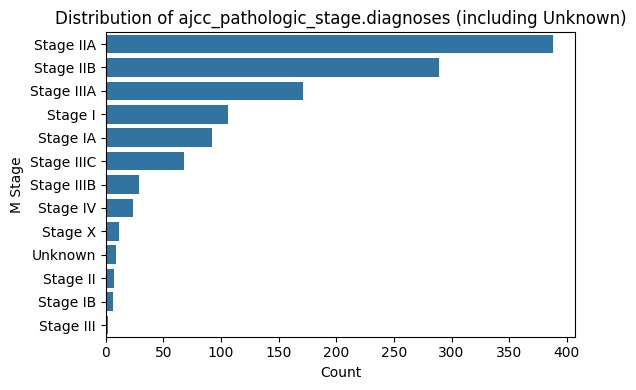

In [92]:
# Plot AJCC Pathologic Stage (ordinal categorical)
plt.figure(figsize=(6, 4))
sns.countplot(
    y=breast_combined_df['ajcc_pathologic_stage.diagnoses'].fillna('Unknown'),
    order=breast_combined_df['ajcc_pathologic_stage.diagnoses'].fillna('Unknown').value_counts().index
)
plt.title("Distribution of ajcc_pathologic_stage.diagnoses (including Unknown)")
plt.xlabel("Count")
plt.ylabel("M Stage")
plt.tight_layout()
plt.show()

In [93]:
breast_combined_df = breast_combined_df[breast_combined_df['ajcc_pathologic_stage.diagnoses'] != 'Unknown']
# Drop rows where the stage is 'Stage X'
breast_combined_df = breast_combined_df[
    (breast_combined_df['ajcc_pathologic_stage.diagnoses'] != 'Stage X') &
    (breast_combined_df['ajcc_pathologic_stage.diagnoses'].notna())
]

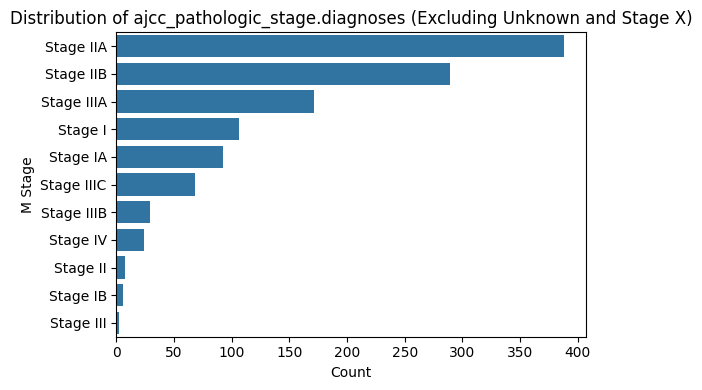

In [94]:
# Plot AJCC Pathologic Stage (ordinal categorical)
plt.figure(figsize=(6, 4))
sns.countplot(
    y=breast_combined_df['ajcc_pathologic_stage.diagnoses'].fillna('Unknown'),
    order=breast_combined_df['ajcc_pathologic_stage.diagnoses'].fillna('Unknown').value_counts().index
)
plt.title("Distribution of ajcc_pathologic_stage.diagnoses (Excluding Unknown and Stage X)")
plt.xlabel("Count")
plt.ylabel("M Stage")
plt.tight_layout()
plt.show()

In [95]:
# Define the stages to be labeled as "1"
stage_1_2_values = ['Stage I', 'Stage IA', 'Stage IB', 'Stage II', 'Stage IIA', 'Stage IIB']

# Create new binary column: 1 if NOT in stage_1_2_values
breast_combined_df['Is_stage_34'] = ~breast_combined_df['ajcc_pathologic_stage.diagnoses'].isin(stage_1_2_values)
breast_combined_df['Is_stage_34'] = breast_combined_df['Is_stage_34'].astype(int)
# Optional: check distribution
print(breast_combined_df['Is_stage_34'].value_counts())


Is_stage_34
0    888
1    294
Name: count, dtype: int64


In [96]:
#we impute weight using linear regressin
from sklearn.linear_model import LinearRegression
import pandas as pd

# Select rows where weight is known
known_weights = breast_combined_df[breast_combined_df['initial_weight.samples'].notnull()]
unknown_weights = breast_combined_df[breast_combined_df['initial_weight.samples'].isnull()]

# Choose features to predict weight
features = ['age_at_index.demographic', 'Is_stage_34']  # Add more if available

# Drop rows with missing values in features
known_weights = known_weights.dropna(subset=features)

# Train regression model
X_train = known_weights[features]
y_train = known_weights['initial_weight.samples']

model = LinearRegression()
model.fit(X_train, y_train)

# Predict for missing weights
X_predict = unknown_weights[features]
predicted_weights = model.predict(X_predict)

# Fill in the predicted values
breast_combined_df.loc[unknown_weights.index, 'initial_weight.samples'] = predicted_weights


We select only those metadata variables from the dataframe


In [97]:
# List of target variables (as they appear in your dataset)
selected_columns = [
    'OS',  # overall survival status (0 = alive, 1 = died)
    'ajcc_pathologic_stage.diagnoses',
    'age_at_index.demographic',
    'disease_type',
    'initial_weight.samples',
    'primary_diagnosis.diagnoses',
    'prior_malignancy.diagnoses',
    'race.demographic',
    'id',
    'Is_stage_34'
    ]

# Select only the columns that exist in the DataFrame
existing_columns = [col for col in selected_columns if col in breast_combined_df.columns]

# Create a new DataFrame with just those columns
clinical_subset_df = breast_combined_df[existing_columns]
clinical_subset_df

,OS,ajcc_pathologic_stage.diagnoses,age_at_index.demographic,disease_type,initial_weight.samples,primary_diagnosis.diagnoses,prior_malignancy.diagnoses,race.demographic,id,Is_stage_34
0,0,Stage IIA,57.0,Ductal and Lobular Neoplasms,230.0,"Infiltrating duct carcinoma, NOS",yes,white,03da7a65-fa2f-42cb-a709-5fe8736f21d3,0
1,1,Stage IIIA,70.0,Ductal and Lobular Neoplasms,160.0,"Infiltrating duct carcinoma, NOS",yes,white,d0b78f3f-a198-437a-ab8c-204345d3b75d,1
2,0,Stage IIA,63.0,Ductal and Lobular Neoplasms,470.0,"Infiltrating duct carcinoma, NOS",no,asian,dbcad60f-86c7-41e3-b0ae-baa39c9f83dd,0
3,0,Stage IIA,47.0,Ductal and Lobular Neoplasms,90.0,"Infiltrating duct carcinoma, NOS",no,white,b379bfb8-284e-4300-8325-85cfd6809cb8,0
4,0,Stage IIB,67.0,Ductal and Lobular Neoplasms,50.0,"Infiltrating duct carcinoma, NOS",no,white,1502c7d7-1535-4e56-9f34-30623acd50d5,0
...,...,...,...,...,...,...,...,...,...,...
1198,0,Stage IIA,51.0,Ductal and Lobular Neoplasms,240.0,"Infiltrating duct carcinoma, NOS",no,white,22b35927-1c3f-4f98-ba42-deafc56b677a,0
1199,0,Stage I,37.0,Ductal and Lobular Neoplasms,70.0,"Infiltrating duct carcinoma, NOS",no,white,71fc8941-4cfb-47ea-a533-873d38f8c95c,0
1200,0,Stage IIA,64.0,Ductal and Lobular Neoplasms,140.0,"Infiltrating duct carcinoma, NOS",no,white,33b7bf50-53f4-4839-aa83-9665f85671d8,0
1201,1,Stage IA,74.0,Ductal and Lobular Neoplasms,80.0,"Lobular carcinoma, NOS",no,white,1402082d-25c9-4148-8a1e-f58450b706bb,0


In [98]:
output_path = r'C:/Users/elisa/OneDrive/Desktop/clinical_subset_nodummy.csv'
clinical_subset_df.to_csv(output_path, index=False)


In [ ]:
# #disease_type is almost binary, so we do Binary Encoding
# # Binary encode: 1 if 'Ductal and Lobular Neoplasms', else 0
# breast_combined_df['is_ductal_lobular'] = (
#     breast_combined_df['disease_type'] == 'Ductal and Lobular Neoplasms'
# ).astype(int)

# # Drop the original column
# breast_combined_df = breast_combined_df.drop(columns=['disease_type'])


In [99]:
clinical_subset_df['prior_malignancy_binary'] = (clinical_subset_df['prior_malignancy.diagnoses'] == 'Yes').astype(int)


C:\Users\elisa\AppData\Local\Temp\ipykernel_32316\3603338973.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  clinical_subset_df['prior_malignancy_binary'] = (clinical_subset_df['prior_malignancy.diagnoses'] == 'Yes').astype(int)


In [100]:
# Categorical columns to encode
cat_cols = ['ajcc_pathologic_stage.diagnoses', 'disease_type', 'primary_diagnosis.diagnoses', 'race.demographic']

# 3. One-hot encode categorical columns and ensure they're integers
dummies = pd.get_dummies(clinical_subset_df[cat_cols], drop_first=True).astype(int)

# 4. Add dummy variables to original DataFrame
clinical_subset_df = pd.concat([clinical_subset_df, dummies], axis=1)

# 5. Drop original categorical columns + original binary source
clinical_subset_df = clinical_subset_df.drop(columns=cat_cols + ['prior_malignancy.diagnoses'])


In [101]:
print(clinical_subset_df.head())
print(clinical_subset_df.shape)
clinical_subset_df

   OS  age_at_index.demographic  initial_weight.samples                                    id  Is_stage_34  prior_malignancy_binary  ajcc_pathologic_stage.diagnoses_Stage IA  ajcc_pathologic_stage.diagnoses_Stage IB  ajcc_pathologic_stage.diagnoses_Stage II  ajcc_pathologic_stage.diagnoses_Stage IIA  ...  primary_diagnosis.diagnoses_Paget disease and infiltrating duct carcinoma of breast  primary_diagnosis.diagnoses_Papillary carcinoma, NOS  primary_diagnosis.diagnoses_Phyllodes tumor, malignant  primary_diagnosis.diagnoses_Pleomorphic carcinoma  primary_diagnosis.diagnoses_Secretory carcinoma of breast  primary_diagnosis.diagnoses_Tubular adenocarcinoma  race.demographic_asian  race.demographic_black or african american  race.demographic_not reported  race.demographic_white
0   0                      57.0                   230.0  03da7a65-fa2f-42cb-a709-5fe8736f21d3            0                        0                                         0                                         

,OS,age_at_index.demographic,initial_weight.samples,id,Is_stage_34,prior_malignancy_binary,ajcc_pathologic_stage.diagnoses_Stage IA,ajcc_pathologic_stage.diagnoses_Stage IB,ajcc_pathologic_stage.diagnoses_Stage II,ajcc_pathologic_stage.diagnoses_Stage IIA,...,primary_diagnosis.diagnoses_Paget disease and infiltrating duct carcinoma of breast,"primary_diagnosis.diagnoses_Papillary carcinoma, NOS","primary_diagnosis.diagnoses_Phyllodes tumor, malignant",primary_diagnosis.diagnoses_Pleomorphic carcinoma,primary_diagnosis.diagnoses_Secretory carcinoma of breast,primary_diagnosis.diagnoses_Tubular adenocarcinoma,race.demographic_asian,race.demographic_black or african american,race.demographic_not reported,race.demographic_white
0,0,57.0,230.0,03da7a65-fa2f-42cb-a709-5fe8736f21d3,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
1,1,70.0,160.0,d0b78f3f-a198-437a-ab8c-204345d3b75d,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2,0,63.0,470.0,dbcad60f-86c7-41e3-b0ae-baa39c9f83dd,0,0,0,0,0,1,...,0,0,0,0,0,0,1,0,0,0
3,0,47.0,90.0,b379bfb8-284e-4300-8325-85cfd6809cb8,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
4,0,67.0,50.0,1502c7d7-1535-4e56-9f34-30623acd50d5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,0,51.0,240.0,22b35927-1c3f-4f98-ba42-deafc56b677a,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
1199,0,37.0,70.0,71fc8941-4cfb-47ea-a533-873d38f8c95c,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1200,0,64.0,140.0,33b7bf50-53f4-4839-aa83-9665f85671d8,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,1
1201,1,74.0,80.0,1402082d-25c9-4148-8a1e-f58450b706bb,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [102]:
output_path = r'C:/Users/elisa/OneDrive/Desktop/clinical_subset_dummy.csv'
clinical_subset_df.to_csv(output_path, index=False)

In [ ]:
# # One-hot encode race.demographic
# race_dummies = pd.get_dummies(breast_combined_df['race.demographic'], prefix='race', drop_first=True)

# # Concatenate the new dummy columns
# breast_combined_df = pd.concat([breast_combined_df, race_dummies], axis=1)

# # Drop the original column
# breast_combined_df = breast_combined_df.drop(columns=['race.demographic'])


In [ ]:
# # one hot encoding of ethnicity.demographic
# # One-hot encode with drop_first=True
# ethnicity_dummies = pd.get_dummies(breast_combined_df['ethnicity.demographic'], 
#                                     prefix='ethnicity', 
#                                     drop_first=True)

# # Add the new columns to the DataFrame
# breast_combined_df = pd.concat([breast_combined_df, ethnicity_dummies], axis=1)

# # Drop the original column
# breast_combined_df = breast_combined_df.drop(columns=['ethnicity.demographic'])


In [ ]:
# # Binary encode: 1 if 'Alive', 0 if 'Dead'
# breast_combined_df['is_alive'] = (
#     breast_combined_df['vital_status.demographic'] == 'Alive'
# ).astype(int)

# # Drop the original column
# breast_combined_df.drop(columns=['vital_status.demographic'], inplace=True)


In [ ]:
# # Binary encode: 1 if 'Not Reported', 0 if 'No'
# breast_combined_df['synchronous_malignancy_reported'] = (
#     breast_combined_df['synchronous_malignancy.diagnoses'] == 'Not Reported'
# ).astype(int)

# # Drop the original column
# breast_combined_df = breast_combined_df.drop(columns=['synchronous_malignancy.diagnoses'])


In [ ]:
# def encode_prior_malignancy(value):
#     if value == 'yes':
#         return 1
#     elif value == 'no':
#         return 0
#     else:
#         return -1  # or use -1 if your model supports it

# breast_combined_df['prior_malignancy_encoded'] = breast_combined_df['prior_malignancy.diagnoses'].apply(encode_prior_malignancy)
# breast_combined_df = breast_combined_df.drop(columns=['prior_malignancy.diagnoses'])


In [ ]:
# def encode_prior_treatment(value):
#     if value == 'Yes':
#         return 1
#     elif value == 'No':
#         return 0
#     else:
#         return -1

# breast_combined_df['prior_treatment_encoded'] = breast_combined_df['prior_treatment.diagnoses'].apply(encode_prior_treatment)

# # Drop the original column
# breast_combined_df = breast_combined_df.drop(columns=['prior_treatment.diagnoses'])


In [ ]:
# # Step 1: Convert string representations of lists to actual Python lists
# breast_combined_df['treatment_or_therapy.treatments.diagnoses'] = breast_combined_df['treatment_or_therapy.treatments.diagnoses'].apply(ast.literal_eval)

# # Step 2: Split into two new columns
# breast_combined_df[['treatment_flag', 'diagnosis_flag']] = pd.DataFrame(
#     breast_combined_df['treatment_or_therapy.treatments.diagnoses'].tolist(),
#     index=breast_combined_df.index
# )

# # Step 3: Map values: 'yes' → 1, 'no' → 0, 'not reported' → -1
# mapping = {'yes': 1, 'no': 0, 'not reported': -1}

# breast_combined_df['treatment_flag_encoded'] = breast_combined_df['treatment_flag'].map(mapping)
# breast_combined_df['diagnosis_flag_encoded'] = breast_combined_df['diagnosis_flag'].map(mapping)

# # Drop original column if not needed
# breast_combined_df.drop(columns=['treatment_or_therapy.treatments.diagnoses'], inplace=True)


In [ ]:
# # Mapping categories to numeric values
# mapping = {'yes': 1, 'no': 0, 'not reported': -1}

# # Apply mapping
# breast_combined_df['treatment_flag'] = breast_combined_df['treatment_flag'].map(mapping)
# breast_combined_df['diagnosis_flag'] = breast_combined_df['diagnosis_flag'].map(mapping)


In [ ]:
# # One-hot encode the 'tumor_descriptor.samples' column
# tumor_dummies = pd.get_dummies(
#     breast_combined_df['tumor_descriptor.samples'],
#     prefix='tumor_sample',
#     drop_first=True
# )

# # Concatenate the new columns with the original DataFrame
# breast_combined_df = pd.concat([breast_combined_df, tumor_dummies], axis=1)

# # Drop the original column if no longer needed
# breast_combined_df.drop(columns=['tumor_descriptor.samples'], inplace=True)


In [ ]:
# # One-hot encode the 'sample_type.samples' column with drop_first=True
# sample_type_dummies = pd.get_dummies(
#     breast_combined_df['sample_type.samples'],
#     prefix='sample_type',
#     drop_first=True
# )

# # Concatenate the new dummy columns to the original DataFrame
# breast_combined_df = pd.concat([breast_combined_df, sample_type_dummies], axis=1)

# # Drop the original 'sample_type.samples' column
# breast_combined_df.drop(columns=['sample_type.samples'], inplace=True)


In [ ]:
# # Convert boolean to int and store in a new column
# breast_combined_df['oct_embedded_encoded'] = breast_combined_df['oct_embedded.samples'].astype(int)

# # Drop the original column
# breast_combined_df.drop(columns=['oct_embedded.samples'], inplace=True)


In [ ]:
# # Convert True/False to 1/0
# breast_combined_df['is_ffpe_encoded'] = breast_combined_df['is_ffpe.samples'].astype(int)

# # Drop the original column
# breast_combined_df.drop(columns=['is_ffpe.samples'], inplace=True)


In [ ]:
# # One-hot encode 'tissue_type.samples' and drop the first category
# tissue_type_dummies = pd.get_dummies(
#     breast_combined_df['tissue_type.samples'],
#     prefix='tissue_type',
#     drop_first=True
# )

# # Concatenate the new dummy column to the DataFrame
# breast_combined_df = pd.concat([breast_combined_df, tissue_type_dummies], axis=1)

# # Drop the original column
# breast_combined_df.drop(columns=['tissue_type.samples'], inplace=True)


In [ ]:
# # Check for non-numeric columns
# non_numeric_columns = breast_combined_df.select_dtypes(exclude=['number']).columns
# print("\nNon-numeric (categorical or object) columns:")
# print(non_numeric_columns.tolist())



Non-numeric (categorical or object) columns:
['ajcc_pathologic_stage.diagnoses', 'race_asian', 'race_black or african american', 'race_not reported', 'race_white', 'ethnicity_not hispanic or latino', 'ethnicity_not reported', 'T_grouped_T2', 'T_grouped_T3', 'T_grouped_T4', 'T_grouped_TX', 'N_grouped_N1', 'N_grouped_N2', 'N_grouped_N3', 'N_grouped_NX', 'M_grouped_M1', 'M_grouped_Other', 'tumor_sample_Not Applicable', 'tumor_sample_Primary', 'sample_type_Primary Tumor', 'sample_type_Solid Tissue Normal', 'tissue_type_Tumor']


In [ ]:
# cols_to_convert = [
#     'race_asian', 'race_black or african american', 'race_not reported', 'race_white',
#     'ethnicity_not hispanic or latino', 'ethnicity_not reported',
#     'T_grouped_T2', 'T_grouped_T3', 'T_grouped_T4', 'T_grouped_TX',
#     'N_grouped_N1', 'N_grouped_N2', 'N_grouped_N3', 'N_grouped_NX',
#     'M_grouped_M1', 'M_grouped_Other',
#     'tumor_sample_Not Applicable', 'tumor_sample_Primary',
#     'sample_type_Primary Tumor', 'sample_type_Solid Tissue Normal',
#     'tissue_type_Tumor'
# ]

# # Convert True/False to 1/0
# breast_combined_df[cols_to_convert] = breast_combined_df[cols_to_convert].astype(int)


In [ ]:
# no_gene_breast_df = breast_combined_df.loc[:, ~breast_combined_df.columns.str.startswith('ENSG')]
# no_gene_breast_df

,OS.time,OS,age_at_index.demographic,year_of_birth.demographic,days_to_death.demographic,ajcc_pathologic_stage.diagnoses,year_of_diagnosis.diagnoses,age_at_earliest_diagnosis_in_years.diagnoses.xena_derived,days_to_collection.samples,initial_weight.samples,...,diagnosis_flag,treatment_flag_encoded,diagnosis_flag_encoded,tumor_sample_Not Applicable,tumor_sample_Primary,sample_type_Primary Tumor,sample_type_Solid Tissue Normal,oct_embedded_encoded,is_ffpe_encoded,tissue_type_Tumor
0,643.0,0,57.0,1953.0,0.0,Stage IIA,2010.0,57.153425,221.0,230.0,...,1,0,1,0,1,1,0,0,0,1
1,172.0,1,70.0,1940.0,172.0,Stage IIIA,2010.0,70.665753,212.0,160.0,...,1,0,1,0,1,1,0,0,0,1
2,508.0,0,63.0,1947.0,0.0,Stage IIA,2010.0,63.936986,163.0,470.0,...,0,1,0,0,1,1,0,1,0,1
3,554.0,0,47.0,1962.0,0.0,Stage IIA,2009.0,47.328767,364.0,90.0,...,1,1,1,0,1,1,0,1,0,1
4,1326.0,0,67.0,1936.0,0.0,Stage IIB,2003.0,67.920548,2781.0,50.0,...,1,1,1,0,1,1,0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,1926.0,0,51.0,1957.0,0.0,Stage IIA,2008.0,51.345205,541.0,240.0,...,1,0,1,0,1,1,0,1,0,1
1199,1855.0,0,37.0,1972.0,0.0,Stage I,2009.0,37.454795,416.0,70.0,...,1,1,1,0,1,1,0,0,0,1
1200,1732.0,0,64.0,1946.0,0.0,Stage IIA,2010.0,64.575342,247.0,140.0,...,1,1,1,0,1,1,0,0,0,1
1201,3926.0,1,74.0,1923.0,3926.0,Stage IA,1997.0,74.101370,4565.0,80.0,...,0,0,0,0,1,1,0,1,0,1


-----------------------------------------

In [133]:
#Read files IÑIGO
# Load the CSV files
clinical_subset_dummy = pd.read_csv("C:/Users/elisa/OneDrive/Desktop/clinical_subset_dummy.csv")
#clinical_subset_nodummy = pd.read_csv(base_path_eli + "clinical_subset_nodummy.csv")
gene_expression_only_breast = pd.read_csv("C:/Users/elisa/OneDrive/Desktop/gene_expression_only_breast.csv")

In [113]:
clinical_subset_dummy.shape

(1182, 49)

In [139]:
gene_expression_only_breast.shape

(1203, 33005)

In [140]:
breast = pd.merge(
    clinical_subset_dummy.drop_duplicates(subset="id"),
    gene_expression_only_breast.drop_duplicates(subset="id"),
    on="id",
    how="inner"
)


In [141]:
breast.shape

(1053, 33053)

In [142]:
# Drop duplicate rows based on 'id' column
clinical_subset_dummy = clinical_subset_dummy.drop_duplicates(subset="id").copy()
gene_expression_only_breast = gene_expression_only_breast.drop_duplicates(subset="id").copy()


In [143]:
# 1. Get the set of IDs present in the inner join (breast)
common_ids = set(breast['id'].dropna().unique())

# 2. Filter clinical_subset_dummy
clinical_filtered = clinical_subset_dummy[clinical_subset_dummy['id'].isin(common_ids)].copy()

# 3. Filter gene_expression_only_breast
gene_filtered = gene_expression_only_breast[gene_expression_only_breast['id'].isin(common_ids)].copy()


In [144]:
clinical_filtered.shape

(1053, 49)

In [145]:
gene_filtered.shape

(1053, 33005)

In [146]:
# Select only the columns you want from breast
breast_subset = breast[['id', 'OS', 'Is_stage_34']]

# Merge with gene_filtered
gene_filtered_y = pd.merge(gene_filtered, breast_subset, on='id', how='inner')


In [147]:
gene_filtered_y.shape

(1053, 33007)

In [148]:
gene_filtered_y.to_csv("gene_expression_only_breast_final.csv", index=False)
clinical_subset_dummy.to_csv("clinical_subset_dummy_final.csv", index=False)
breast.to_csv("breast_combined_final.csv", index=False)

Gene Expression Data: (1053, 33007)
Clinical Data: (1053, 49)
Combined Data: (1053, 33053)


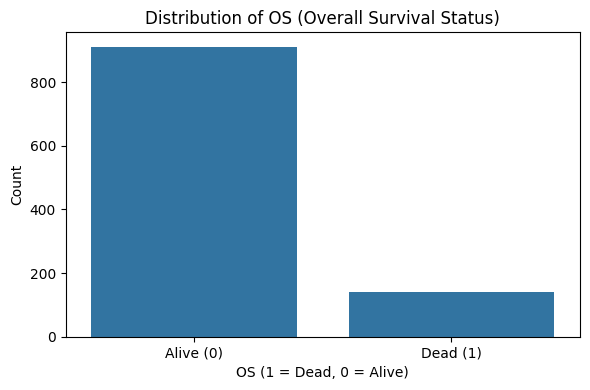

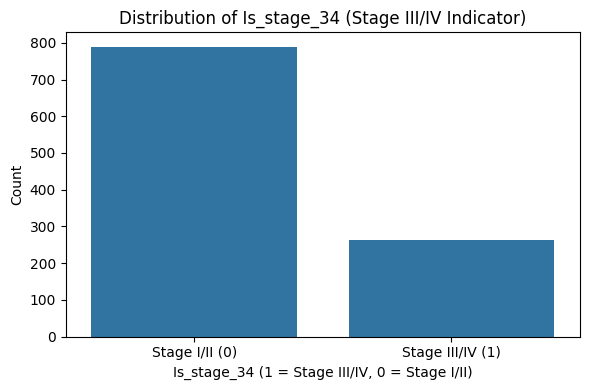

In [9]:
import pandas as pd
import os
import seaborn as sns
import matplotlib.pyplot as plt

# Define base path
base_path = "C:/Users/usuario/OneDrive/Desktop/Thesis/personal_files/breast_final/"

# Define file paths
gene_expr_path = os.path.join(base_path, "gene_expression_only_breast_final.csv")
clinical_path = os.path.join(base_path, "clinical_subset_dummy_final.csv")
combined_path = os.path.join(base_path, "breast_combined_final.csv")

# Load CSV files
gene_expression_df = pd.read_csv(gene_expr_path)
clinical_df = pd.read_csv(clinical_path)
combined_df = pd.read_csv(combined_path)

# Print shape for confirmation
print("Gene Expression Data:", gene_expression_df.shape)
print("Clinical Data:", clinical_df.shape)
print("Combined Data:", combined_df.shape)

# --- Plot OS distribution (1 = Dead, 0 = Alive) ---
plt.figure(figsize=(6, 4))
sns.countplot(x='OS', data=clinical_df)
plt.title('Distribution of OS (Overall Survival Status)')
plt.xlabel('OS (1 = Dead, 0 = Alive)')
plt.ylabel('Count')
plt.xticks([0, 1], ['Alive (0)', 'Dead (1)'])
plt.tight_layout()
plt.show()

# --- Plot Is_stage_34 distribution ---
plt.figure(figsize=(6, 4))
sns.countplot(x='Is_stage_34', data=clinical_df)
plt.title('Distribution of Is_stage_34 (Stage III/IV Indicator)')
plt.xlabel('Is_stage_34 (1 = Stage III/IV, 0 = Stage I/II)')
plt.ylabel('Count')
plt.xticks([0, 1], ['Stage I/II (0)', 'Stage III/IV (1)'])
plt.tight_layout()
plt.show()


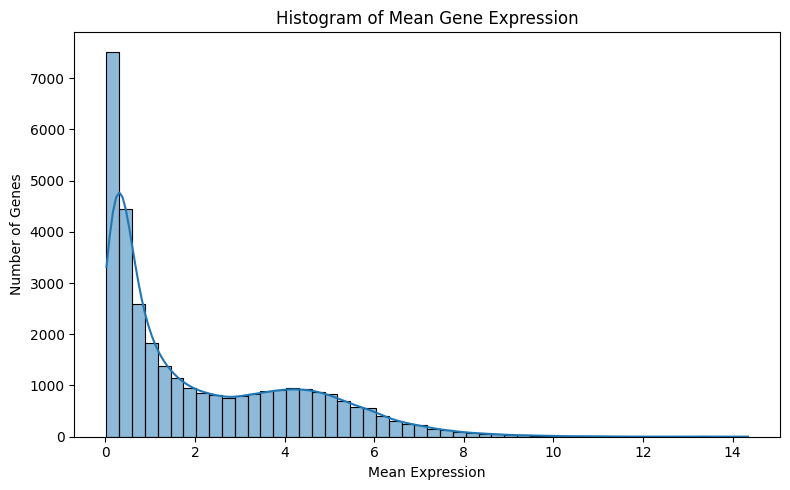

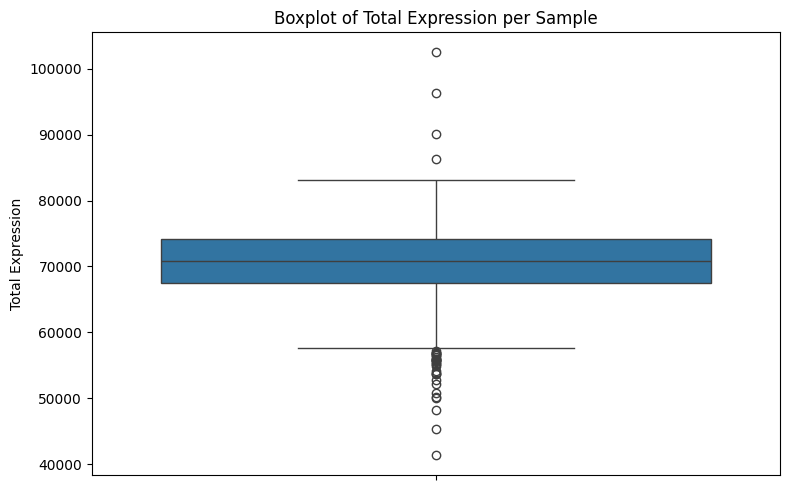

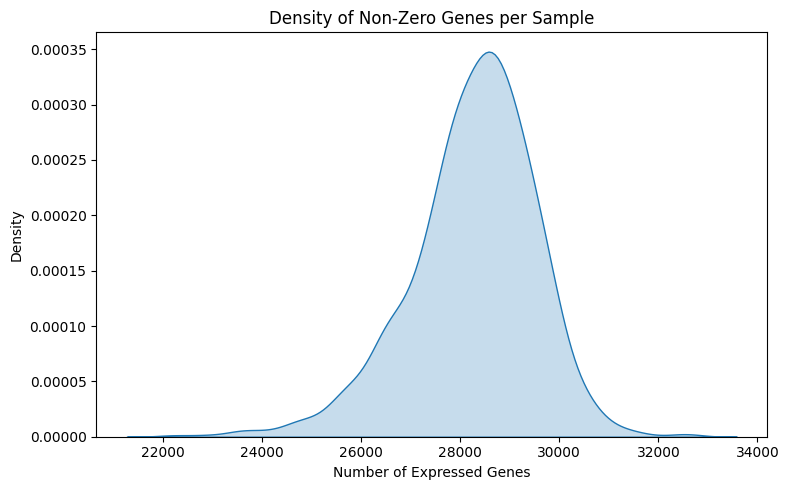

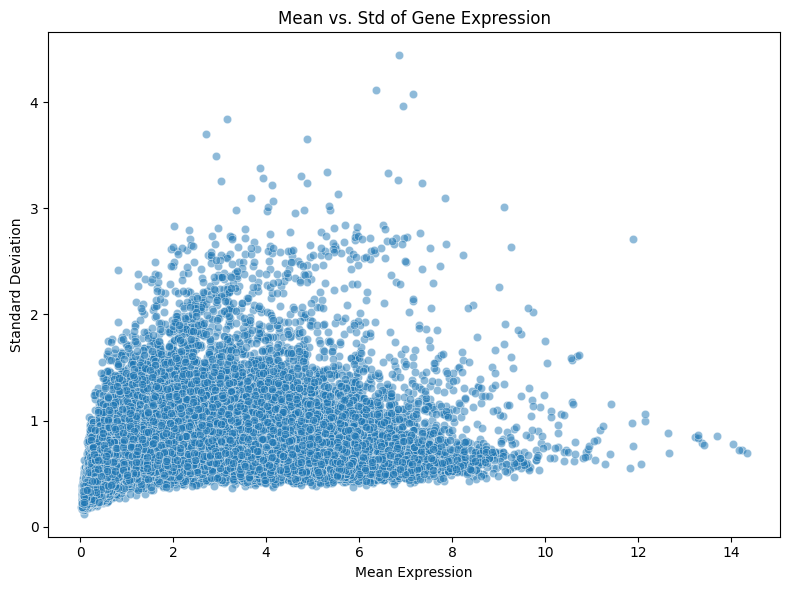

In [10]:
df = pd.read_csv(gene_expr_path)

genes_only = df.drop(columns=['id'])

# Summary for genes
gene_summary = pd.DataFrame({
    'mean': genes_only.mean(),
    'std': genes_only.std()
})

# Summary for samples
sample_summary = pd.DataFrame({
    'sum_expr': genes_only.sum(axis=1),
    'mean_expr': genes_only.mean(axis=1),
    'non_zero_genes': (genes_only > 0).sum(axis=1)
})

# Plot 1: Histogram of Mean Gene Expression
plt.figure(figsize=(8, 5))
sns.histplot(gene_summary['mean'], bins=50, kde=True)
plt.title('Histogram of Mean Gene Expression')
plt.xlabel('Mean Expression')
plt.ylabel('Number of Genes')
plt.tight_layout()
plt.show()

# Plot 2: Boxplot of Total Expression per Sample
plt.figure(figsize=(8, 5))
sns.boxplot(y=sample_summary['sum_expr'])
plt.title('Boxplot of Total Expression per Sample')
plt.ylabel('Total Expression')
plt.tight_layout()
plt.show()

# Plot 3: Density Plot of Number of Non-Zero Genes per Sample
plt.figure(figsize=(8, 5))
sns.kdeplot(sample_summary['non_zero_genes'], fill=True)
plt.title('Density of Non-Zero Genes per Sample')
plt.xlabel('Number of Expressed Genes')
plt.ylabel('Density')
plt.tight_layout()
plt.show()

# Plot 4: Scatterplot of Mean vs. Standard Deviation for Genes
plt.figure(figsize=(8, 6))
sns.scatterplot(data=gene_summary, x='mean', y='std', alpha=0.5)
plt.title('Mean vs. Std of Gene Expression')
plt.xlabel('Mean Expression')
plt.ylabel('Standard Deviation')
plt.tight_layout()
plt.show()